In [1]:
import os
import sys
sys.path.append(os.path.abspath(os.path.dirname(os.getcwd())))

import warnings
warnings.filterwarnings("ignore")
import pickle
from utils import *
import seaborn as sn
import matplotlib.pyplot as plt

In [2]:
os.getcwd()

'/hwfssz1/ST_BIOINTEL/P20Z10200N0039/06.groups/04.Algorithm_tools/zhangchao5/pycharm_codes/2023/BatchEffectsRemoval_HOME/jupyter'

In [3]:
with open("/jdfssz1/ST_BIOINTEL/P20Z10200N0157/Bioinformatic_Frontier_Algorithms/05.user/zhangchao5/jupyter_codes/mouse_embyro/DPLFC/sample3_res.pkl", "rb") as f:
    data = pickle.load(f)

In [4]:
path = "/jdfssz1/ST_BIOINTEL/P20Z10200N0157/Bioinformatic_Frontier_Algorithms/05.user/zhangchao5/jupyter_codes/mouse_embyro/DPLFC"

In [6]:
raw_datas = [sc.read_h5ad(osp.join(path, f)) for f in sorted(os.listdir(path)) if f.endswith("h5ad") and f.startswith("dplfc")]
raw_datas

[AnnData object with n_obs × n_vars = 3639 × 33538
     obs: 'celltype'
     var: 'gene_ids', 'feature_types', 'genome'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 3673 × 33538
     obs: 'celltype'
     var: 'gene_ids', 'feature_types', 'genome'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 3592 × 33538
     obs: 'celltype'
     var: 'gene_ids', 'feature_types', 'genome'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 3460 × 33538
     obs: 'celltype'
     var: 'gene_ids', 'feature_types', 'genome'
     obsm: 'spatial']

In [95]:
from collections import defaultdict

In [96]:
tmp_dict = defaultdict()

In [565]:
ari_df = pd.DataFrame(columns=["raw", "spatialign", "harmony", "combat", "bbknn", "mnn", "scanorama", "precast", "graphst", "scalex"])

In [357]:
lisi_df = pd.DataFrame(index=[0.5, 1, 2], columns=["raw", "spatialign", "harmony", "combat", "bbknn", "mnn", "scanorama", "precast", "graphst", "scalex"])

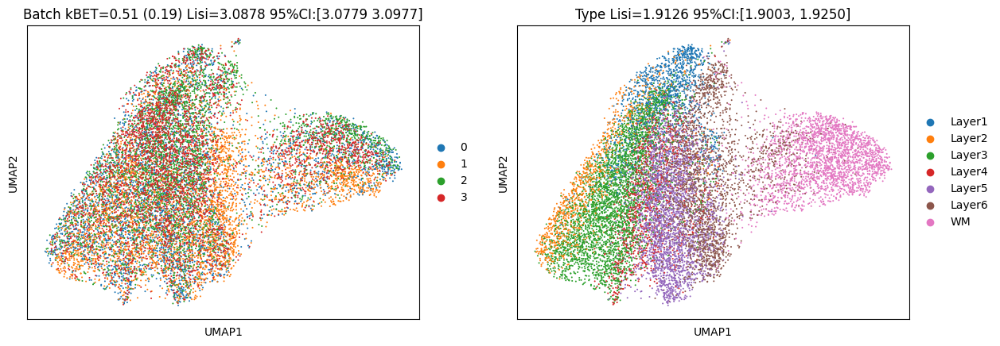

In [91]:
raw_ilisi, raw_clisi = visualization(data["raw"].copy(), use_rep="X_pca", is_neighobr=True, is_leiden=False, celltype="celltype")

In [97]:
tmp_dict["raw"] = {"data": data["raw"].copy(), "ilisi": raw_ilisi, "clisi": raw_clisi}

In [358]:
lisi_df["raw"].loc[0.5] = f_beta_lisi(raw_ilisi, raw_clisi, beta=0.5)

In [360]:
lisi_df["raw"].loc[1] = f_beta_lisi(raw_ilisi, raw_clisi, beta=1)

In [361]:
lisi_df["raw"].loc[2] = f_beta_lisi(raw_ilisi, raw_clisi, beta=2)

In [ ]:
correct_datas = [sc.read_h5ad(f) for f in sorted(os.listdir("./")) if f.endswith("h5ad") and f.startswith("corr")]
correct_datas

In [223]:
merge_correct = AnnData.concatenate(*correct_datas)
merge_correct = merge_correct[~merge_correct.obs["celltype"].isna()]

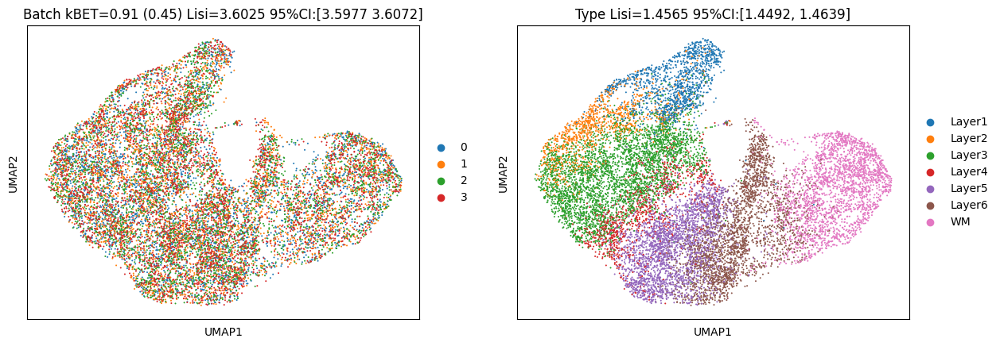

In [691]:
correct_ilisi, correct_clisi = visualization(merge_correct, use_rep="correct", is_neighobr=True, is_leiden=False, celltype="celltype")

In [692]:
tmp_dict["spatialign"] = {"data": merge_correct, "ilisi": correct_ilisi, "clisi": correct_clisi}

In [362]:
lisi_df["spatialign"].loc[0.5] = f_beta_lisi(correct_ilisi, correct_clisi, beta=0.5)

In [365]:
lisi_df["spatialign"].loc[1] = f_beta_lisi(correct_ilisi, correct_clisi, beta=1)

In [366]:
lisi_df["spatialign"].loc[2] = f_beta_lisi(correct_ilisi, correct_clisi, beta=2)

In [698]:
mapping_cluster(merge_correct, celltype="celltype")

best resolution: 2.3000, ari: 0.5967
ari: 0.5967


In [569]:
ari_df["spatialign"] = [adjusted_rand_score(merge_correct.obs["celltype"], merge_correct.obs["mappingtype"])]

### harmony

In [20]:
harmony_data = data["raw"].copy()

In [22]:
sc.external.pp.harmony_integrate(harmony_data, key="batch")

2023-06-19 10:03:30,503 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-06-19 10:03:35,665 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-06-19 10:03:38,723 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-06-19 10:03:41,900 - harmonypy - INFO - Converged after 3 iterations
INFO:harmonypy:Converged after 3 iterations


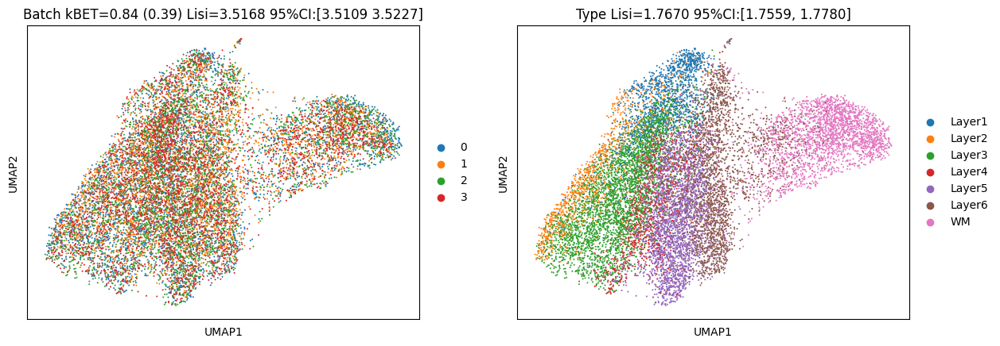

In [23]:
harmony_ilisi, harmony_clisi = visualization(harmony_data, use_rep="X_pca_harmony", is_neighobr=True, is_leiden=False, celltype="celltype")

In [99]:
tmp_dict["harmony"] = {"data": harmony_data, "ilisi": harmony_ilisi, "clisi": harmony_clisi}

In [367]:
lisi_df["harmony"].loc[0.5] = f_beta_lisi(harmony_ilisi, harmony_clisi, beta=0.5)

In [368]:
lisi_df["harmony"].loc[1] =f_beta_lisi(harmony_ilisi, harmony_clisi, beta=1)

In [369]:
lisi_df["harmony"].loc[2] =f_beta_lisi(harmony_ilisi, harmony_clisi, beta=2)

In [347]:
mapping_cluster(harmony_data, celltype="celltype")

best resolution: 1.9000, ari: 0.3933
ari: 0.3933


In [571]:
ari_df["harmony"] = [adjusted_rand_score(harmony_data.obs["celltype"], harmony_data.obs["mappingtype"])]

### combat

In [27]:
combat_data = data["raw"].copy()

In [28]:
sc.pp.combat(combat_data)

In [29]:
pca_lowrank(combat_data, n_component=100)

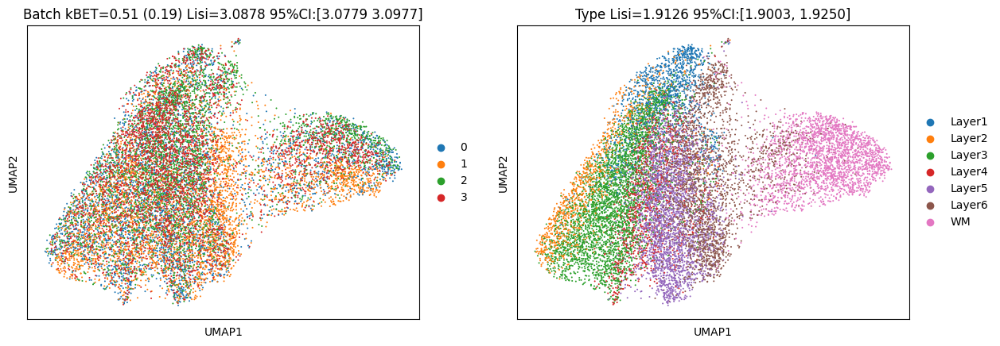

In [30]:
combat_ilisi, combat_clisi = visualization(harmony_data, use_rep="X_pca", is_neighobr=True, is_leiden=False, celltype="celltype")

In [100]:
tmp_dict["combat"] = {"data": combat_data, "ilisi": combat_ilisi, "clisi": combat_clisi}

In [370]:
lisi_df["combat"].loc[0.5] = f_beta_lisi(combat_ilisi, combat_clisi, beta=0.5)

In [371]:
lisi_df["combat"].loc[1] = f_beta_lisi(combat_ilisi, combat_clisi, beta=1)

In [372]:
lisi_df["combat"].loc[2] = f_beta_lisi(combat_ilisi, combat_clisi, beta=2)

In [348]:
mapping_cluster(combat_data, celltype="celltype")

best resolution: 2.9000, ari: 0.4022
ari: 0.4022


In [572]:
ari_df["combat"] = [adjusted_rand_score(combat_data.obs["celltype"], combat_data.obs["mappingtype"])]

### scanorama

In [34]:
import scanorama

In [35]:
scanorama_data = data["raw"].copy()
scanorama_list = [scanorama_data[scanorama_data.obs["batch"] == b] for b in scanorama_data.obs["batch"].cat.categories]

In [36]:
scanorama_res = scanorama.correct_scanpy(scanorama_list, return_dimred=True)

Found 14325 genes among all datasets
[[0.         0.46822558 0.70751542 0.50626639]
 [0.         0.         0.3942793  0.39037139]
 [0.         0.         0.         0.74901851]
 [0.         0.         0.         0.        ]]
Processing datasets (2, 3)
Processing datasets (0, 2)
Processing datasets (0, 3)
Processing datasets (0, 1)
Processing datasets (1, 2)
Processing datasets (1, 3)


In [38]:
scanorama_merge = AnnData.concatenate(*scanorama_res)

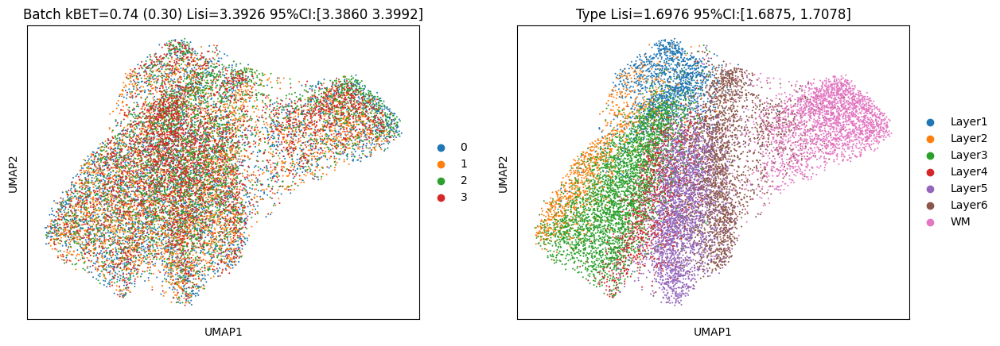

In [39]:
scanorama_ilisi, scanorama_clisi = visualization(scanorama_merge, use_rep="X_scanorama", is_neighobr=True, is_leiden=False, celltype="celltype")

In [101]:
tmp_dict["scanorama"] = {"data": scanorama_merge, "ilisi": scanorama_ilisi, "clisi": scanorama_clisi}

In [373]:
lisi_df["scanorama"].loc[0.5] = f_beta_lisi(scanorama_ilisi, scanorama_clisi, beta=0.5)

In [374]:
lisi_df["scanorama"].loc[1] = f_beta_lisi(scanorama_ilisi, scanorama_clisi, beta=1)

In [375]:
lisi_df["scanorama"].loc[2] = f_beta_lisi(scanorama_ilisi, scanorama_clisi, beta=2)

In [349]:
mapping_cluster(scanorama_merge, celltype="celltype")

best resolution: 2.6000, ari: 0.4787
ari: 0.4787


In [573]:
ari_df["scanorama"] = [adjusted_rand_score(scanorama_merge.obs["celltype"], scanorama_merge.obs["mappingtype"])]

### bbknn

In [43]:
bbknn_data = data["raw"].copy()

In [44]:
sc.external.pp.bbknn(bbknn_data)

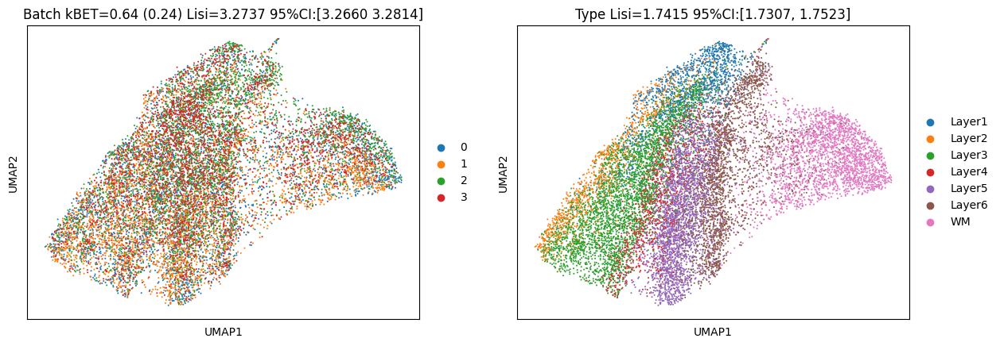

In [45]:
bbknn_ilisi, bbknn_clisi = visualization(bbknn_data, use_rep="X_pca", is_neighobr=False, is_leiden=False, celltype="celltype")

In [102]:
tmp_dict["bbknn"] = {"data": bbknn_data, "ilisi": bbknn_ilisi, "clisi": bbknn_clisi}

In [376]:
lisi_df["bbknn"].loc[0.5] = f_beta_lisi(bbknn_ilisi, bbknn_clisi, beta=0.5)

In [377]:
lisi_df["bbknn"].loc[1] = f_beta_lisi(bbknn_ilisi, bbknn_clisi, beta=1)

In [378]:
lisi_df["bbknn"].loc[2] = f_beta_lisi(bbknn_ilisi, bbknn_clisi, beta=2)

In [350]:
mapping_cluster(bbknn_data, celltype="celltype")

best resolution: 2.8000, ari: 0.4551
ari: 0.4551


In [678]:
ari_df["bbknn"] = [adjusted_rand_score(bbknn_data.obs["celltype"], bbknn_data.obs["mappingtype"])]

### mnn

In [49]:
mnn_data = data["raw"].copy()

In [51]:
mnn_res, _, _ = sc.external.pp.mnn_correct(
    mnn_data[mnn_data.obs["batch"]=="0"], 
    mnn_data[mnn_data.obs["batch"]=="1"],
    mnn_data[mnn_data.obs["batch"]=="2"],
    mnn_data[mnn_data.obs["batch"]=="3"],
)

Performing cosine normalization...
Starting MNN correct iteration. Reference batch: 0
Step 1 of 3: processing batch 1
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 2 of 3: processing batch 2
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 3 of 3: processing batch 3
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
MNN correction complete. Gathering output...
Packing AnnData object...
Done.


In [52]:
pca_lowrank(mnn_res, n_component=100)

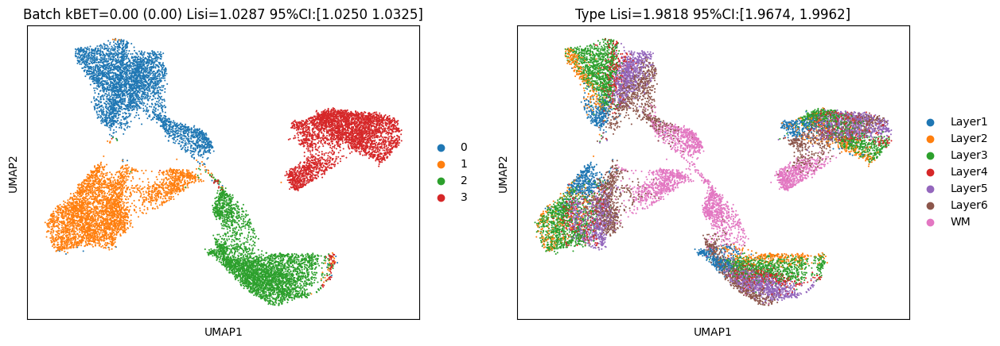

In [53]:
mnn_ilisi, mnn_clisi = visualization(mnn_res, use_rep="X_pca", is_neighobr=True, is_leiden=False, celltype="celltype")

In [103]:
tmp_dict["mnn"] = {"data": mnn_res, "ilisi": mnn_ilisi, "clisi": mnn_clisi}

In [379]:
lisi_df["mnn"].loc[0.5] = f_beta_lisi(mnn_ilisi, mnn_clisi, beta=0.5)

In [380]:
lisi_df["mnn"].loc[1] = f_beta_lisi(mnn_ilisi, mnn_clisi, beta=1)

In [381]:
lisi_df["mnn"].loc[2] = f_beta_lisi(mnn_ilisi, mnn_clisi, beta=2)

In [351]:
mapping_cluster(mnn_res, celltype="celltype")

best resolution: 2.3000, ari: 0.3421
ari: 0.3421


In [679]:
ari_df["mnn"] = [adjusted_rand_score(mnn_res.obs["celltype"], mnn_res.obs["mappingtype"])]

### scalex

In [54]:
from scalex import SCALEX

In [58]:
scalex_res = SCALEX([f for f in sorted(os.listdir("./")) if f.endswith("h5ad") and f.startswith("dplfc")], 
       min_cells=20, 
       min_features=20, 
       processed=False, 
       seed=42, 
       ignore_umap=True, 
       show=False)

INFO:root:Raw dataset shape: (14364, 33538)
2023-06-19 12:08:02,212 - root - INFO - Raw dataset shape: (14364, 33538)
INFO:root:Preprocessing
2023-06-19 12:08:02,214 - root - INFO - Preprocessing
INFO:root:Filtering cells
2023-06-19 12:08:02,246 - root - INFO - Filtering cells
INFO:root:Filtering features
2023-06-19 12:08:03,411 - root - INFO - Filtering features
INFO:root:Normalizing total per cell
2023-06-19 12:08:04,231 - root - INFO - Normalizing total per cell
INFO:root:Log1p transforming
2023-06-19 12:08:04,375 - root - INFO - Log1p transforming
INFO:root:Finding variable features
2023-06-19 12:08:04,869 - root - INFO - Finding variable features
INFO:root:Batch specific maxabs scaling
2023-06-19 12:08:08,424 - root - INFO - Batch specific maxabs scaling
INFO:root:Processed dataset shape: (14364, 2000)
2023-06-19 12:08:09,651 - root - INFO - Processed dataset shape: (14364, 2000)
INFO:root:model
VAE(
  (encoder): Encoder(
    (enc): NN(
      (net): ModuleList(
        (0): Block(

In [66]:
scalex_res = scalex_res[~scalex_res.obs["celltype"].isna()]

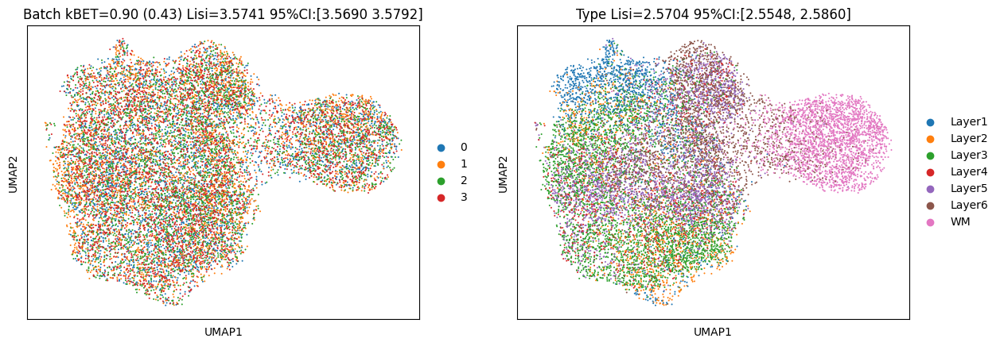

In [71]:
scalex_ilisi, scalex_clisi = visualization(scalex_res, use_rep="latent", is_neighobr=True, is_leiden=False, celltype="celltype")

In [104]:
tmp_dict["scalex"] = {"data": scalex_res, "ilisi": scalex_ilisi, "clisi": scalex_clisi}

In [382]:
lisi_df["scalex"].loc[0.5] = f_beta_lisi(scalex_ilisi, scalex_clisi, beta=0.5)

In [383]:
lisi_df["scalex"].loc[1] = f_beta_lisi(scalex_ilisi, scalex_clisi, beta=1)

In [384]:
lisi_df["scalex"].loc[2] = f_beta_lisi(scalex_ilisi, scalex_clisi, beta=2)

In [352]:
mapping_cluster(scalex_res, celltype="celltype")

best resolution: 2.6000, ari: 0.2965
ari: 0.2965


In [680]:
ari_df["scalex"] = [adjusted_rand_score(scalex_res.obs["celltype"], scalex_res.obs["mappingtype"])]

### precast

In [75]:
precast_data = data["precast"]

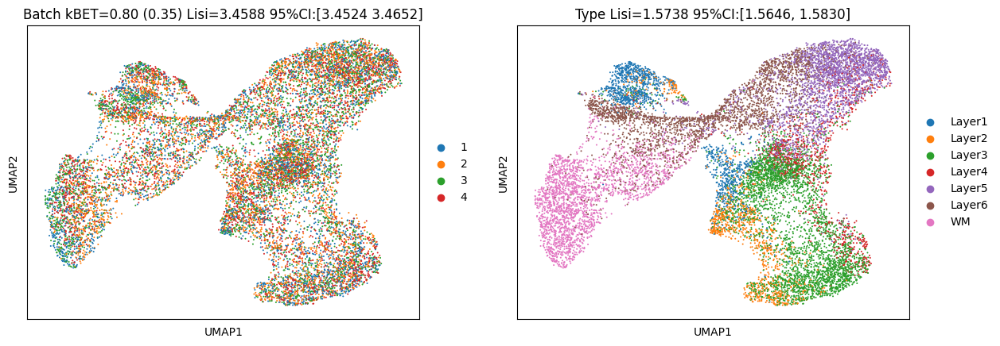

In [77]:
precast_ilisi, precast_clisi = visualization(precast_data, use_rep="X_precast", is_neighobr=True, is_leiden=False, celltype="celltype")

In [105]:
tmp_dict["precast"] = {"data": precast_data, "ilisi": precast_ilisi, "clisi": precast_clisi}

In [385]:
lisi_df["precast"].loc[0.5] = f_beta_lisi(precast_ilisi, precast_clisi, beta=0.5)

In [386]:
lisi_df["precast"].loc[1] = f_beta_lisi(precast_ilisi, precast_clisi, beta=1)

In [387]:
lisi_df["precast"].loc[2] = f_beta_lisi(precast_ilisi, precast_clisi, beta=2)

In [353]:
mapping_cluster(precast_data, celltype="celltype")

best resolution: 2.1000, ari: 0.5540
ari: 0.5540


In [681]:
ari_df["precast"] = [adjusted_rand_score(precast_data.obs["celltype"], precast_data.obs["mappingtype"])]

### graphST

In [82]:
graphst_data = data["raw"].copy()

In [84]:
from GraphST import GraphST

Begin to train ST data...


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [01:31<00:00,  6.58it/s]


Optimization finished for ST data!


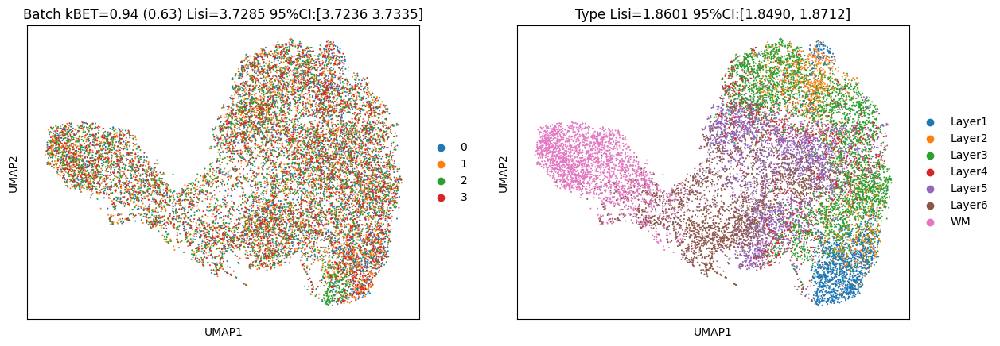

In [85]:
device = torch.device('cuda:0')
model = GraphST.GraphST(graphst_data, device=device, random_seed=42)
graphst_res = model.train()
pca_lowrank(graphst_res, n_component=100, use_rep="emb")

graphst_ilisi, graphst_clisi = visualization(graphst_res, use_rep="X_pca", is_neighobr=True, is_leiden=False, celltype="celltype")

In [106]:
tmp_dict["graphst"] = {"data": graphst_res, "ilisi": graphst_ilisi, "clisi": graphst_clisi}

In [388]:
lisi_df["graphst"].loc[0.5] = f_beta_lisi(graphst_ilisi, graphst_clisi, beta=0.5)

In [389]:
lisi_df["graphst"].loc[1] = f_beta_lisi(graphst_ilisi, graphst_clisi, beta=1)

In [390]:
lisi_df["graphst"].loc[2] = f_beta_lisi(graphst_ilisi, graphst_clisi, beta=2)

In [354]:
mapping_cluster(graphst_res, celltype="celltype")

best resolution: 2.9000, ari: 0.4378
ari: 0.4378


In [682]:
ari_df["graphst"] = [adjusted_rand_score(graphst_res.obs["celltype"], graphst_res.obs["mappingtype"])]

In [109]:
with open("sample3_res.pkl", "wb") as f:
    pickle.dump(tmp_dict, f)

In [391]:
lisi_df

,raw,spatialign,harmony,combat,bbknn,mnn,scanorama,precast,graphst,scalex
0.5,0.782515,0.862394,0.818767,0.782515,0.798962,0.049136,0.81009,0.839041,0.786094,0.684598
1.0,0.746349,0.840238,0.818728,0.746349,0.769687,0.020406,0.775168,0.822399,0.827817,0.733861
2.0,0.713379,0.819192,0.81869,0.713379,0.742481,0.012877,0.743133,0.806405,0.874217,0.790763


In [683]:
ari_df

,raw,spatialign,harmony,combat,bbknn,mnn,scanorama,precast,graphst,scalex
0,NaN,0.596749,0.393284,0.402236,0.455125,0.34208,0.478695,0.553989,0.437839,0.296488


In [685]:
color_mapping = dict(zip(merge_correct.obs["celltype"].cat.categories, merge_correct.uns["celltype_colors"]))
color_mapping

{'Layer1': '#1f77b4',
 'Layer2': '#ff7f0e',
 'Layer3': '#2ca02c',
 'Layer4': '#d62728',
 'Layer5': '#9467bd',
 'Layer6': '#8c564b',
 'WM': '#e377c2'}

In [416]:
merge_correct.uns["mappingtype_colors"] = [color_mapping[c] for c in merge_correct.obs["mappingtype"].cat.categories]

In [699]:
for key in tmp_dict.keys():
    tmp_dict[key]["data"].uns["mappingtype_colors"] = [color_mapping[c] for c in tmp_dict[key]["data"].obs["mappingtype"].cat.categories]

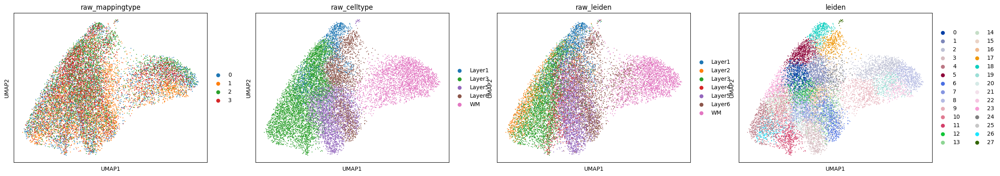

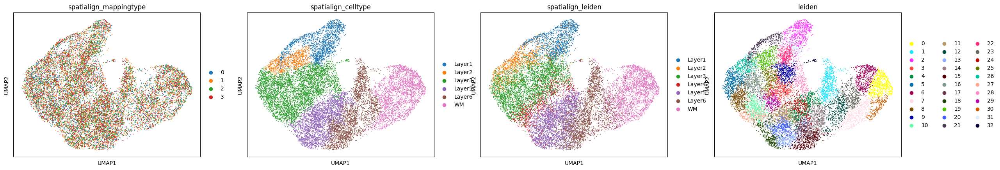

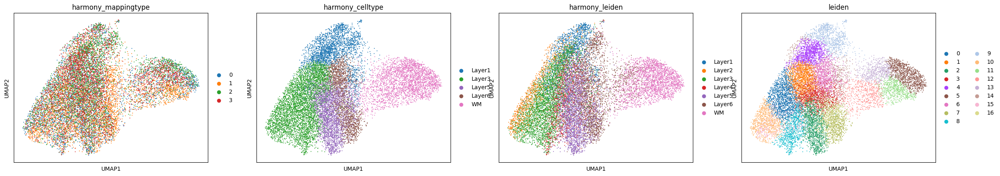

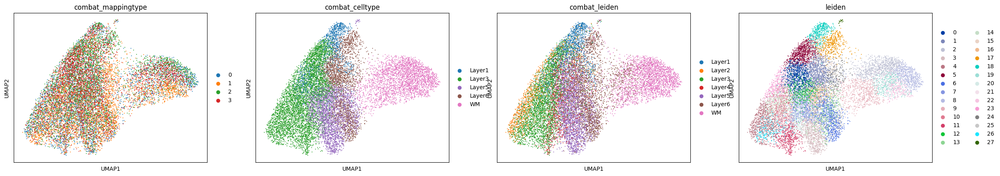

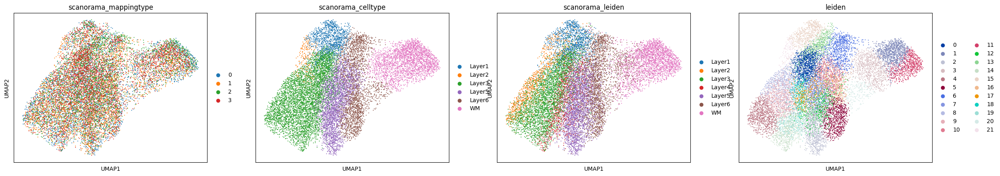

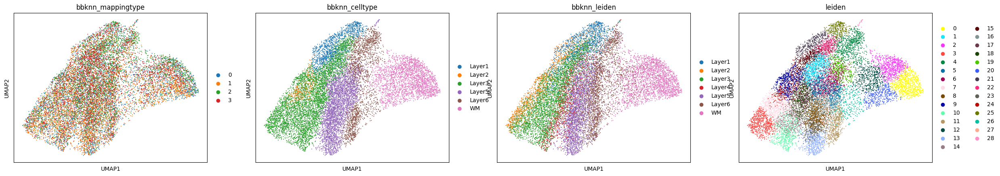

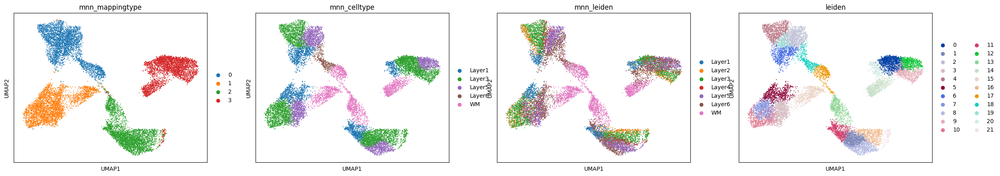

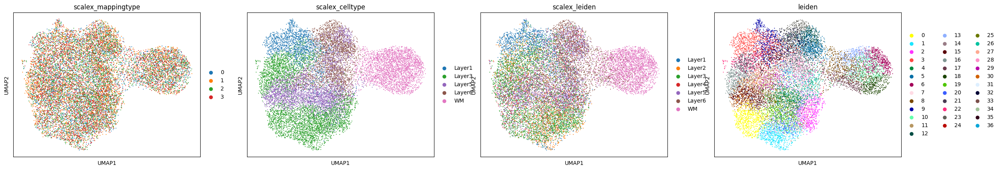

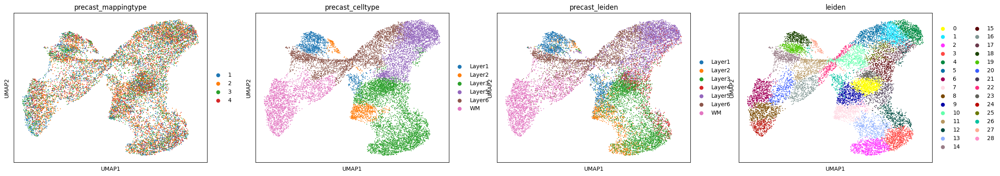

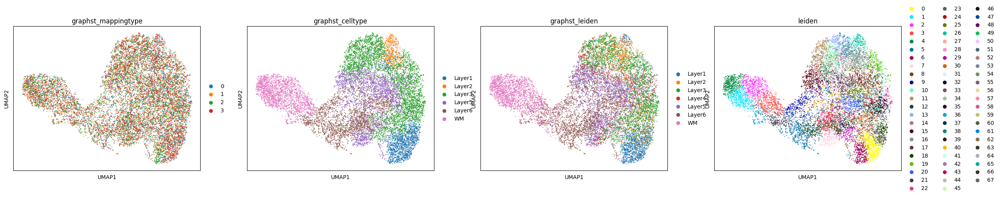

In [805]:
for key in tmp_dict.keys():
    sub_data = tmp_dict[key]["data"]
    sc.pl.umap(sub_data, color=["batch", "mappingtype", "celltype", "leiden"], title=[f"{key}_mappingtype", f"{key}_celltype", f"{key}_leiden"])

### --------------------------------

In [701]:
embedding_name = {
    "raw": "X_pca", 
    "spatialign": "correct", 
    'scanorama': "X_scanorama", 
    'bbknn': "X_pca",
    'mnn': "X_pca", 
    'harmony': "X_pca_harmony", 
    'combat': "X_pca", 
    'scgen': 'corrected_latent', 
    'graphst': "X_pca", 
    'scalex': 'latent', 
    'precast': 'X_precast'}

In [727]:
names = ['spatialign', 'precast', 'graphst', 'scalex', 'harmony', 'combat', 'bbknn', 'scanorama', 'mnn']
names2 = ['Spatialign', 'PRECAST', 'GraphST', 'SCALEX', 'Harmony', 'Combat', 'BBKNN', 'Scanorama', 'MNN']

In [739]:
ilisi_df = pd.DataFrame(columns=names)
clisi_df = pd.DataFrame(columns=names)

In [743]:
for name in names:
    ilisi_df[name] = tmp_dict[name]["ilisi"]
    clisi_df[name] = 1 - tmp_dict[name]["clisi"]

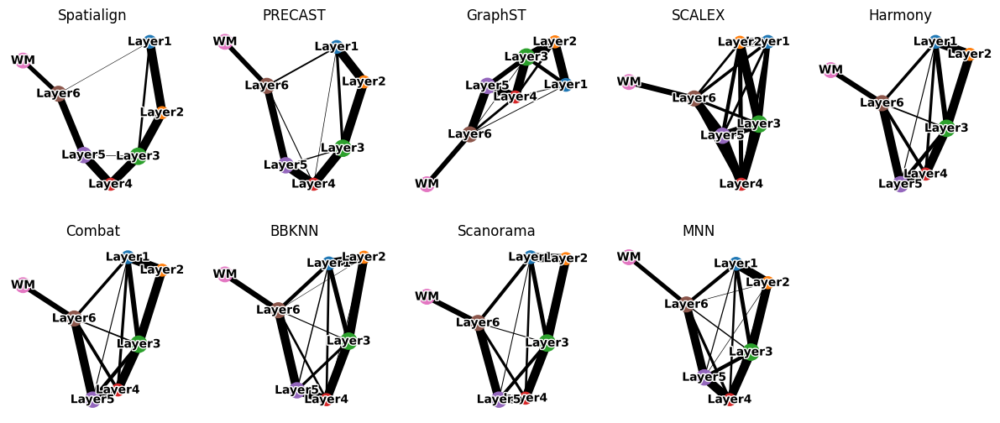

In [1055]:
fig, axs = plt.subplots(2, 5, figsize=(15, 6))
axs[1, 4].set_frame_on(False)
axs[1, 4].axis("off")

for idx, key in enumerate(names):
    ax = axs[idx//5, idx%5]
    
    sc.tl.paga(tmp_dict[key]["data"], "celltype")
    sc.pl.paga(tmp_dict[key]["data"], threshold=0.05, title=names2[idx], ax=ax, show=False, fontoutline=2)
    ax.set_frame_on(False)
    
fig.subplots_adjust(wspace=0.2, hspace=0.25)
# fig.savefig("paga.pdf", dpi=150, bbox_inches="tight")

### ---------------------------

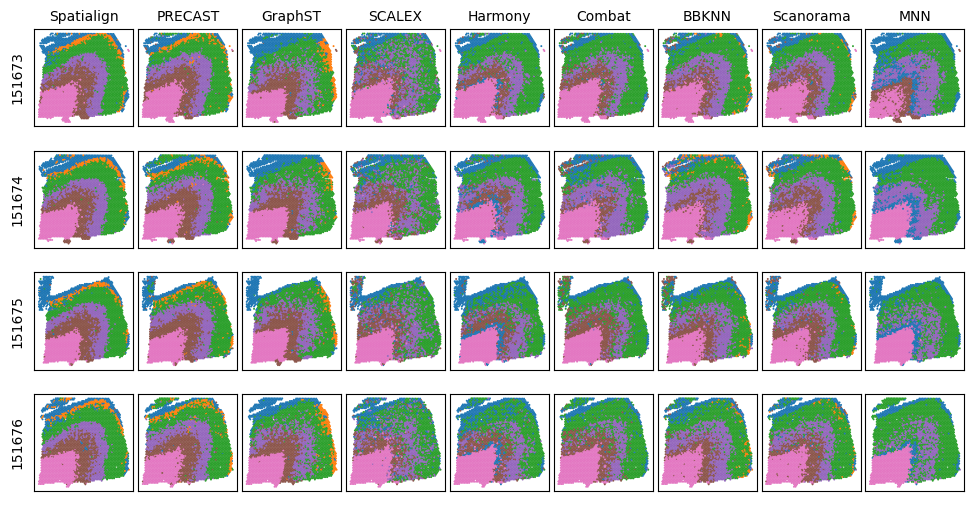

In [1238]:
t_names = names.copy()
t_names2 = names2.copy()
col_names = [151673, 151674, 151675, 151676]

fig, ax = plt.subplots(4, len(t_names), figsize=(12, 6))
for idx1, key in enumerate(t_names):
    tmp_data = tmp_dict[key]["data"]
    # if key == "raw":
    #     hue = "celltype"
    # else:
    #     hue = "color_code"
    #     # hue = "mappingtype"

    color_dict = dict(zip(tmp_data.obs["mappingtype"].cat.categories, tmp_data.uns["mappingtype_colors"]))
    tmp_data.obs["mappingtype_colors"] = tmp_data.obs["mappingtype"].map(color_dict)
    for idx2, c in enumerate(tmp_data.obs["batch"].cat.categories):
        sub_data = tmp_data[tmp_data.obs["batch"] == c]
        if key == "raw":
            if idx2 == 1:
                is_lenged=False
            else:
                is_lenged=False
        else:
            # sub_data.obs[hue] = sub_data.obs["mappingtype"].map(color_dict)
            is_lenged=False
        sn.scatterplot(y=sub_data.obsm["spatial"][:, 0], 
                       x=sub_data.obsm["spatial"][:, 1], 
                       ax=ax[idx2, idx1], 
                       c=sub_data.obs["mappingtype_colors"].values, 
                       s=2, 
                       legend=is_lenged, 
                       linewidth=0, 
                       # palette="Set2"
                      )
        
        ari = adjusted_rand_score(sub_data.obs["celltype"], sub_data.obs["mappingtype"])
        
        ax[idx2, idx1].invert_yaxis()
        ax[idx2, idx1].set_xlabel("")
        ax[idx2, idx1].set_ylabel("")
        ax[idx2, idx1].set_xticks([])
        ax[idx2, idx1].set_yticks([])
        # if idx1 != 0:
        # ax[idx2, idx1].set_title(f"ARI: {ari:.4f}", fontsize=10)
        # ax[idx2, idx1].set_xlabel(f"ARI: {ari:.4f}", fontsize=10)
        if idx2 == 0:
            ax[idx2, idx1].set_title(f"{t_names2[idx1]}", fontsize=10)
            # ax[idx2, idx1].set_xlabel(f"{t_names2[idx1]}", fontsize=10)
        if idx1 == 0:
            ax[idx2, idx1].set_ylabel(f"{col_names[idx2]}", fontsize=10)
        if is_lenged:
            ax[idx2, idx1].legend(bbox_to_anchor=(11.3, 0.35), fontsize=8)
fig.subplots_adjust(wspace=0.05, hspace=0.25)
plt.savefig("alignment_spatial.png", dpi=300, bbox_inches="tight")

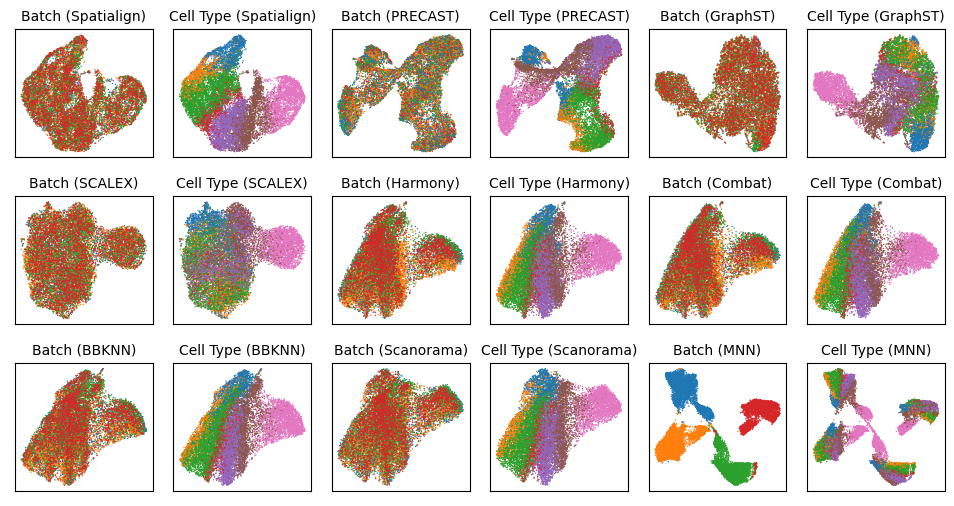

In [1228]:
fig, ax = plt.subplots(3, 6, figsize=(12, 6))

for idx, key in enumerate(names):
    sub_data = tmp_dict[key]["data"]
    col = idx % 3
    row = idx // 3
    if row == 2 and col == 2:
        is_legend1 = False
        is_legend2 = False
    else:
        is_legend1 = False
        is_legend2 = False
    sub_data.obs[["umap1", "umap2"]] = sub_data.obsm["X_umap"]
    
    sn.scatterplot(x="umap1", y="umap2", s=1, data=sub_data.obs, 
               hue="batch", legend=is_legend1, ax=ax[row, 2*col], linewidth=0,
                   # palette="Dark2"
                  )
    sn.scatterplot(x="umap1", y="umap2", s=1, data=sub_data.obs, 
               hue="celltype", legend=is_legend2, ax=ax[row, 2*col+1], linewidth=0, 
                   # palette="tab10"
                  )

    ax[row, 2*col].set_ylabel("")
    ax[row, 2*col+1].set_ylabel("")
    ax[row, 2*col].set_xlabel("")
    ax[row, 2*col].set_xticks([])
    ax[row, 2*col].set_yticks([])
    ax[row, 2*col+1].set_xlabel("")
    ax[row, 2*col+1].set_xticks([])
    ax[row, 2*col+1].set_yticks([])

    ax[row, 2*col].set_title(f"Batch ({names2[idx]})", fontsize=10)
    ax[row, 2*col+1].set_title(f"Cell Type ({names2[idx]})", fontsize=10)
    
    if row == 0:
        alpha = 0
    else:
        alpha = 0
    pos1 = ax[row, 2*col].get_position(True)
    pos2 = ax[row, 2*col+1].get_position(True)


plt.subplots_adjust(wspace=0.15, hspace=0.3)
plt.savefig("alignment_umap.png", dpi=500, bbox_inches="tight")

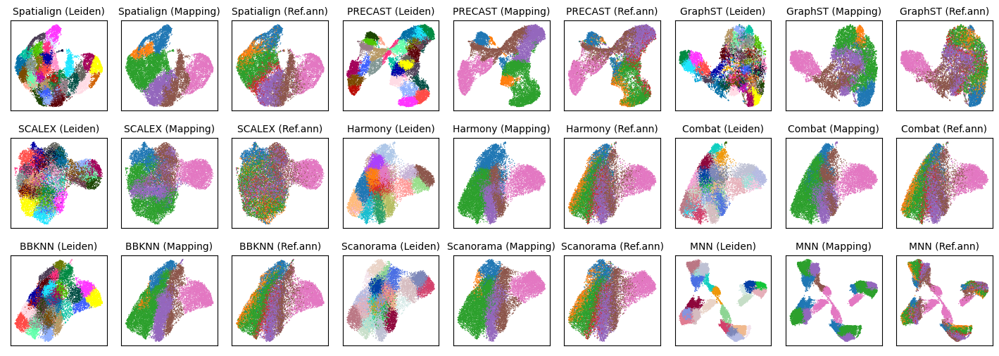

In [1233]:
fig, ax = plt.subplots(3, 9, figsize=(18, 6))

for idx, key in enumerate(names):
    sub_data = tmp_dict[key]["data"]
    col = idx % 3
    row = idx // 3
    if row == 2 and col == 2:
        is_legend1 = False
        is_legend2 = False
    else:
        is_legend1 = False
        is_legend2 = False

    color_dict = dict(zip(sub_data.obs["mappingtype"].cat.categories, sub_data.uns["mappingtype_colors"]))
    sub_data.obs["mappingtype_colors"] = sub_data.obs["mappingtype"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["leiden"].cat.categories, sub_data.uns["leiden_colors"]))
    sub_data.obs["leiden_colors"] = sub_data.obs["leiden"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["celltype"].cat.categories, sub_data.uns["celltype_colors"]))
    sub_data.obs["celltype_colors"] = sub_data.obs["celltype"].map(color_dict)
    
    sub_data.obs[["umap1", "umap2"]] = sub_data.obsm["X_umap"]
    
    sn.scatterplot(x="umap1", y="umap2", s=1, c=sub_data.obs["leiden_colors"].values, 
                   data = sub_data.obs,
               legend=is_legend1, ax=ax[row, 3*col], linewidth=0,
                   # palette="Dark2"
                  )
    sn.scatterplot(x="umap1", y="umap2", s=1, data = sub_data.obs, c=sub_data.obs["mappingtype_colors"], 
                   legend=is_legend2, ax=ax[row, 3*col+1], linewidth=0, 
                   # palette="tab10"
                  )

    sn.scatterplot(x="umap1", y="umap2", s=1, data = sub_data.obs, c=sub_data.obs["celltype_colors"], 
                   legend=is_legend2, ax=ax[row, 3*col+2], linewidth=0, 
                   # palette="tab10"
                  )

    ax[row, 3*col].set_ylabel("")
    ax[row, 3*col+1].set_ylabel("")
    ax[row, 3*col+2].set_ylabel("")
    
    ax[row, 3*col].set_xlabel("")
    ax[row, 3*col+1].set_xlabel("")
    ax[row, 3*col+2].set_xlabel("")
    
    ax[row, 3*col].set_xticks([])
    ax[row, 3*col+1].set_xticks([])
    ax[row, 3*col+2].set_xticks([])
    
    ax[row, 3*col].set_yticks([])
    ax[row, 3*col+1].set_yticks([])
    ax[row, 3*col+2].set_yticks([])
    
    ax[row, 3*col].set_title(f"{names2[idx]} (Leiden)", fontsize=10)
    ax[row, 3*col+1].set_title(f"{names2[idx]} (Mapping)", fontsize=10)
    ax[row, 3*col+2].set_title(f"{names2[idx]} (Ref.ann)", fontsize=10)

plt.subplots_adjust(wspace=0.15, hspace=0.3)

plt.savefig("mapping_umap.png", dpi=300, bbox_inches="tight")

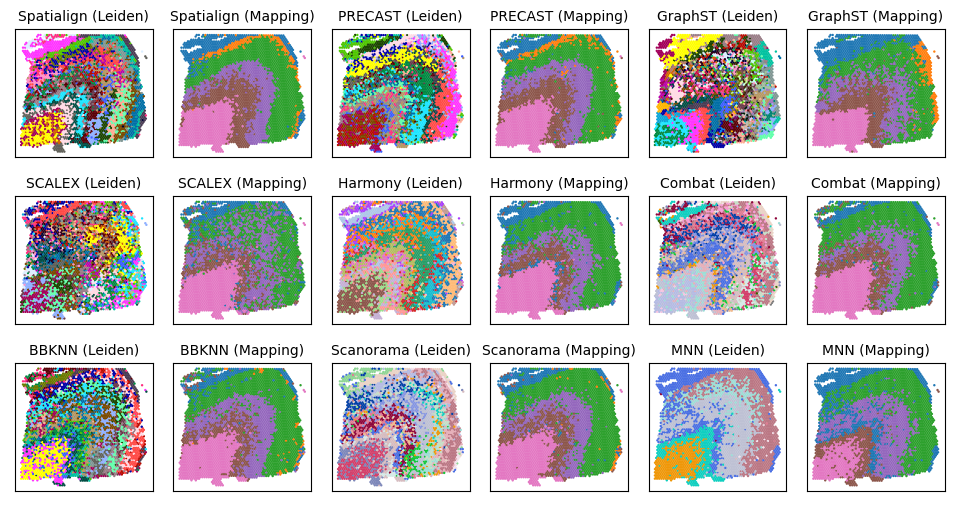

In [1237]:
fig, ax = plt.subplots(3, 6, figsize=(12, 6))

for idx, key in enumerate(names):
    sub_data = tmp_dict[key]["data"]
    sub_data = sub_data[sub_data.obs["batch"] == "1"] if key == "precast" else sub_data[sub_data.obs["batch"] == "0"]
    col = idx % 3
    row = idx // 3
    if row == 2 and col == 2:
        is_legend1 = False
        is_legend2 = False
    else:
        is_legend1 = False
        is_legend2 = False

    color_dict = dict(zip(sub_data.obs["mappingtype"].cat.categories, sub_data.uns["mappingtype_colors"]))
    sub_data.obs["mappingtype_colors"] = sub_data.obs["mappingtype"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["leiden"].cat.categories, sub_data.uns["leiden_colors"]))
    sub_data.obs["leiden_colors"] = sub_data.obs["leiden"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["celltype"].cat.categories, sub_data.uns["celltype_colors"]))
    sub_data.obs["celltype_colors"] = sub_data.obs["celltype"].map(color_dict)
    
    sub_data.obs[["pos_x", "pos_y"]] = sub_data.obsm["spatial"]
    
    sn.scatterplot(y="pos_x", x="pos_y", s=3, c=sub_data.obs["leiden_colors"].values, 
                   data = sub_data.obs,
               legend=is_legend1, ax=ax[row, 2*col], linewidth=0,
                   # palette="Dark2"
                  )
    sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["mappingtype_colors"], 
                   legend=is_legend2, ax=ax[row, 2*col+1], linewidth=0, 
                   # palette="tab10"
                  )

    # sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["celltype_colors"], 
    #                legend=is_legend2, ax=ax[row, 3*col+2], linewidth=0, 
    #                # palette="tab10"
    #               )

    ax[row, 2*col].invert_yaxis()
    ax[row, 2*col+1].invert_yaxis()
    # ax[row, 3*col+2].invert_yaxis()
    
    ax[row, 2*col].set_ylabel("")
    ax[row, 2*col+1].set_ylabel("")
    # ax[row, 3*col+2].set_ylabel("")
    
    ax[row, 2*col].set_xlabel("")
    ax[row, 2*col+1].set_xlabel("")
    # ax[row, 3*col+2].set_xlabel("")
    
    ax[row, 2*col].set_xticks([])
    ax[row, 2*col+1].set_xticks([])
    # ax[row, 3*col+2].set_xticks([])
    
    ax[row, 2*col].set_yticks([])
    ax[row, 2*col+1].set_yticks([])
    # ax[row, 3*col+2].set_yticks([])
    
    ax[row, 2*col].set_title(f"{names2[idx]} (Leiden)", fontsize=10)
    ax[row, 2*col+1].set_title(f"{names2[idx]} (Mapping)", fontsize=10)
    # ax[row, 3*col+2].set_title(f"{names2[idx]} (Ref.ann)", fontsize=10)

plt.subplots_adjust(wspace=0.15, hspace=0.3)
plt.savefig("mapping151673.png", dpi=300, bbox_inches="tight")

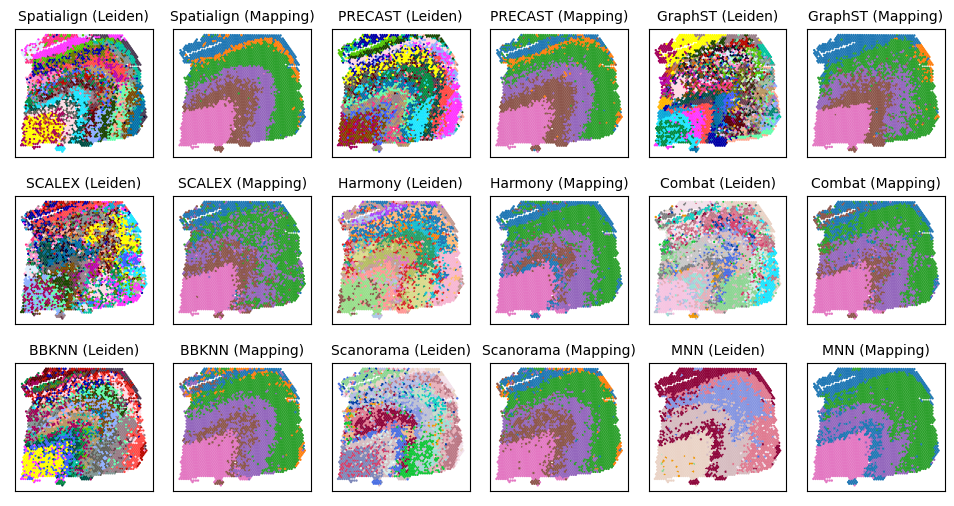

In [1234]:
fig, ax = plt.subplots(3, 6, figsize=(12, 6))

for idx, key in enumerate(names):
    sub_data = tmp_dict[key]["data"]
    sub_data = sub_data[sub_data.obs["batch"] == "2"] if key == "precast" else sub_data[sub_data.obs["batch"] == "1"]
    col = idx % 3
    row = idx // 3
    if row == 2 and col == 2:
        is_legend1 = False
        is_legend2 = False
    else:
        is_legend1 = False
        is_legend2 = False

    color_dict = dict(zip(sub_data.obs["mappingtype"].cat.categories, sub_data.uns["mappingtype_colors"]))
    sub_data.obs["mappingtype_colors"] = sub_data.obs["mappingtype"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["leiden"].cat.categories, sub_data.uns["leiden_colors"]))
    sub_data.obs["leiden_colors"] = sub_data.obs["leiden"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["celltype"].cat.categories, sub_data.uns["celltype_colors"]))
    sub_data.obs["celltype_colors"] = sub_data.obs["celltype"].map(color_dict)
    
    sub_data.obs[["pos_x", "pos_y"]] = sub_data.obsm["spatial"]
    
    sn.scatterplot(y="pos_x", x="pos_y", s=3, c=sub_data.obs["leiden_colors"].values, 
                   data = sub_data.obs,
               legend=is_legend1, ax=ax[row, 2*col], linewidth=0,
                   # palette="Dark2"
                  )
    sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["mappingtype_colors"], 
                   legend=is_legend2, ax=ax[row, 2*col+1], linewidth=0, 
                   # palette="tab10"
                  )

    # sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["celltype_colors"], 
    #                legend=is_legend2, ax=ax[row, 3*col+2], linewidth=0, 
    #                # palette="tab10"
    #               )

    ax[row, 2*col].invert_yaxis()
    ax[row, 2*col+1].invert_yaxis()
    # ax[row, 3*col+2].invert_yaxis()
    
    ax[row, 2*col].set_ylabel("")
    ax[row, 2*col+1].set_ylabel("")
    # ax[row, 3*col+2].set_ylabel("")
    
    ax[row, 2*col].set_xlabel("")
    ax[row, 2*col+1].set_xlabel("")
    # ax[row, 3*col+2].set_xlabel("")
    
    ax[row, 2*col].set_xticks([])
    ax[row, 2*col+1].set_xticks([])
    # ax[row, 3*col+2].set_xticks([])
    
    ax[row, 2*col].set_yticks([])
    ax[row, 2*col+1].set_yticks([])
    # ax[row, 3*col+2].set_yticks([])
    
    ax[row, 2*col].set_title(f"{names2[idx]} (Leiden)", fontsize=10)
    ax[row, 2*col+1].set_title(f"{names2[idx]} (Mapping)", fontsize=10)
    # ax[row, 3*col+2].set_title(f"{names2[idx]} (Ref.ann)", fontsize=10)

plt.subplots_adjust(wspace=0.15, hspace=0.3)
plt.savefig("mapping151674.png", dpi=300, bbox_inches="tight")

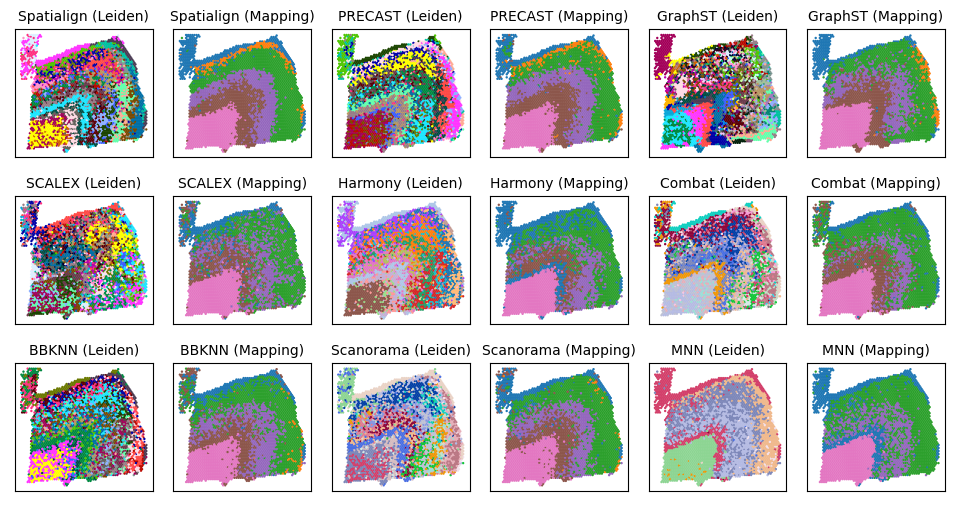

In [1235]:
fig, ax = plt.subplots(3, 6, figsize=(12, 6))

for idx, key in enumerate(names):
    sub_data = tmp_dict[key]["data"]
    sub_data = sub_data[sub_data.obs["batch"] == "3"] if key == "precast" else sub_data[sub_data.obs["batch"] == "2"]
    col = idx % 3
    row = idx // 3
    if row == 2 and col == 2:
        is_legend1 = False
        is_legend2 = False
    else:
        is_legend1 = False
        is_legend2 = False

    color_dict = dict(zip(sub_data.obs["mappingtype"].cat.categories, sub_data.uns["mappingtype_colors"]))
    sub_data.obs["mappingtype_colors"] = sub_data.obs["mappingtype"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["leiden"].cat.categories, sub_data.uns["leiden_colors"]))
    sub_data.obs["leiden_colors"] = sub_data.obs["leiden"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["celltype"].cat.categories, sub_data.uns["celltype_colors"]))
    sub_data.obs["celltype_colors"] = sub_data.obs["celltype"].map(color_dict)
    
    sub_data.obs[["pos_x", "pos_y"]] = sub_data.obsm["spatial"]
    
    sn.scatterplot(y="pos_x", x="pos_y", s=3, c=sub_data.obs["leiden_colors"].values, 
                   data = sub_data.obs,
               legend=is_legend1, ax=ax[row, 2*col], linewidth=0,
                   # palette="Dark2"
                  )
    sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["mappingtype_colors"], 
                   legend=is_legend2, ax=ax[row, 2*col+1], linewidth=0, 
                   # palette="tab10"
                  )

    # sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["celltype_colors"], 
    #                legend=is_legend2, ax=ax[row, 3*col+2], linewidth=0, 
    #                # palette="tab10"
    #               )

    ax[row, 2*col].invert_yaxis()
    ax[row, 2*col+1].invert_yaxis()
    # ax[row, 3*col+2].invert_yaxis()
    
    ax[row, 2*col].set_ylabel("")
    ax[row, 2*col+1].set_ylabel("")
    # ax[row, 3*col+2].set_ylabel("")
    
    ax[row, 2*col].set_xlabel("")
    ax[row, 2*col+1].set_xlabel("")
    # ax[row, 3*col+2].set_xlabel("")
    
    ax[row, 2*col].set_xticks([])
    ax[row, 2*col+1].set_xticks([])
    # ax[row, 3*col+2].set_xticks([])
    
    ax[row, 2*col].set_yticks([])
    ax[row, 2*col+1].set_yticks([])
    # ax[row, 3*col+2].set_yticks([])
    
    ax[row, 2*col].set_title(f"{names2[idx]} (Leiden)", fontsize=10)
    ax[row, 2*col+1].set_title(f"{names2[idx]} (Mapping)", fontsize=10)
    # ax[row, 3*col+2].set_title(f"{names2[idx]} (Ref.ann)", fontsize=10)

plt.subplots_adjust(wspace=0.15, hspace=0.3)
plt.savefig("mapping151675.png", dpi=300, bbox_inches="tight")

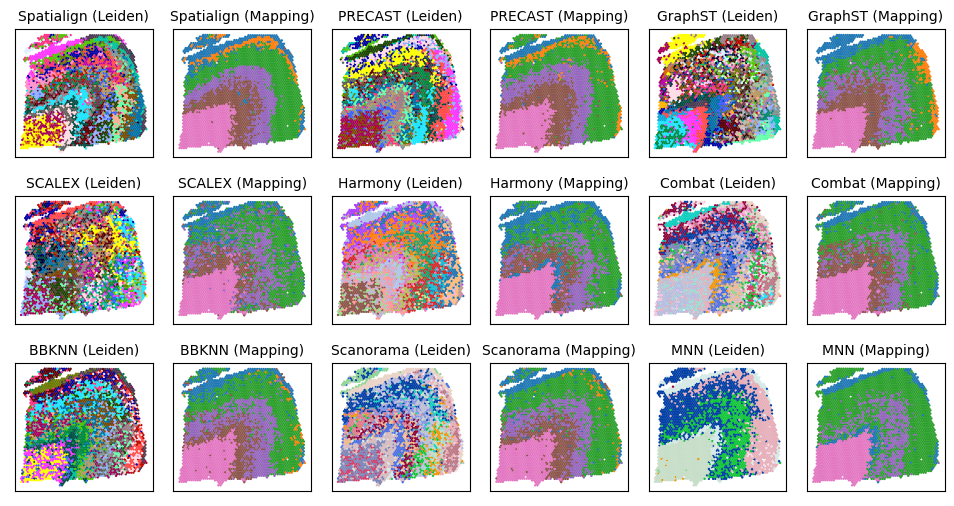

In [1236]:
fig, ax = plt.subplots(3, 6, figsize=(12, 6))

for idx, key in enumerate(names):
    sub_data = tmp_dict[key]["data"]
    sub_data = sub_data[sub_data.obs["batch"] == "4"] if key == "precast" else sub_data[sub_data.obs["batch"] == "3"]
    col = idx % 3
    row = idx // 3
    if row == 2 and col == 2:
        is_legend1 = False
        is_legend2 = False
    else:
        is_legend1 = False
        is_legend2 = False

    color_dict = dict(zip(sub_data.obs["mappingtype"].cat.categories, sub_data.uns["mappingtype_colors"]))
    sub_data.obs["mappingtype_colors"] = sub_data.obs["mappingtype"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["leiden"].cat.categories, sub_data.uns["leiden_colors"]))
    sub_data.obs["leiden_colors"] = sub_data.obs["leiden"].map(color_dict)

    color_dict = dict(zip(sub_data.obs["celltype"].cat.categories, sub_data.uns["celltype_colors"]))
    sub_data.obs["celltype_colors"] = sub_data.obs["celltype"].map(color_dict)
    
    sub_data.obs[["pos_x", "pos_y"]] = sub_data.obsm["spatial"]
    
    sn.scatterplot(y="pos_x", x="pos_y", s=3, c=sub_data.obs["leiden_colors"].values, 
                   data = sub_data.obs,
               legend=is_legend1, ax=ax[row, 2*col], linewidth=0,
                   # palette="Dark2"
                  )
    sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["mappingtype_colors"], 
                   legend=is_legend2, ax=ax[row, 2*col+1], linewidth=0, 
                   # palette="tab10"
                  )

    # sn.scatterplot(y="pos_x", x="pos_y", s=3, data = sub_data.obs, c=sub_data.obs["celltype_colors"], 
    #                legend=is_legend2, ax=ax[row, 3*col+2], linewidth=0, 
    #                # palette="tab10"
    #               )

    ax[row, 2*col].invert_yaxis()
    ax[row, 2*col+1].invert_yaxis()
    # ax[row, 3*col+2].invert_yaxis()
    
    ax[row, 2*col].set_ylabel("")
    ax[row, 2*col+1].set_ylabel("")
    # ax[row, 3*col+2].set_ylabel("")
    
    ax[row, 2*col].set_xlabel("")
    ax[row, 2*col+1].set_xlabel("")
    # ax[row, 3*col+2].set_xlabel("")
    
    ax[row, 2*col].set_xticks([])
    ax[row, 2*col+1].set_xticks([])
    # ax[row, 3*col+2].set_xticks([])
    
    ax[row, 2*col].set_yticks([])
    ax[row, 2*col+1].set_yticks([])
    # ax[row, 3*col+2].set_yticks([])
    
    ax[row, 2*col].set_title(f"{names2[idx]} (Leiden)", fontsize=10)
    ax[row, 2*col+1].set_title(f"{names2[idx]} (Mapping)", fontsize=10)
    # ax[row, 3*col+2].set_title(f"{names2[idx]} (Ref.ann)", fontsize=10)

plt.subplots_adjust(wspace=0.15, hspace=0.3)
plt.savefig("mapping151676.png", dpi=300, bbox_inches="tight")

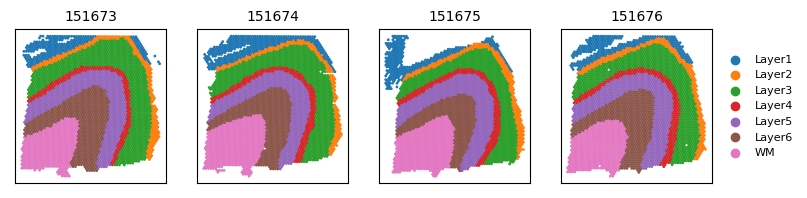

In [943]:
fig, ax = plt.subplots(1, 4, figsize=(9, 2))

for idx, c in enumerate(tmp_dict["raw"]["data"].obs["batch"].cat.categories):
    sub_data = tmp_dict["raw"]["data"][tmp_dict["raw"]["data"].obs["batch"] == c]
    # row = idx // 2
    # col = idx % 2
    if idx == 3:
        is_lenged = True
    else:
        is_lenged = False
        
    sn.scatterplot(y=sub_data.obsm["spatial"][:, 0], 
                       x=sub_data.obsm["spatial"][:, 1], 
                       data=sub_data.obs, 
                       # ax=ax[row, col], 
                       ax=ax[idx], 
                       hue="celltype", 
                       s=4, 
                       legend=is_lenged, 
                       linewidth=0, 
                       # palette="Set2"
                      )
    ax[idx].invert_yaxis()
    ax[idx].set_xlabel("")
    ax[idx].set_ylabel("")
    ax[idx].set_xticks([])
    ax[idx].set_yticks([])
    ax[idx].set_title(f"{col_names[idx]}", fontsize=10)
    if is_lenged:
        ax[idx].legend(bbox_to_anchor=(1.01, 0.9), title="", fontsize=8, frameon=False)
fig.subplots_adjust(wspace=0.2, hspace=0)

fig.savefig("spatial annotation.pdf", dpi=150, bbox_inches="tight")

In [892]:
import cv2

In [893]:
t = sc.read_h5ad("/jdfssz2/ST_BIOINTEL/P20Z10200N0039/06.groups/04.Algorithm_tools/liulin4/linliu/reference_data/DLPFC151673.h5ad")
t

AnnData object with n_obs × n_vars = 3639 × 33538
    obs: 'in_tissue', 'array_row', 'array_col', 'total_counts', 'celltype'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'celltype_colors', 'spatial'
    obsm: 'spatial'

In [894]:
t = t[~t.obs["celltype"].isna()]

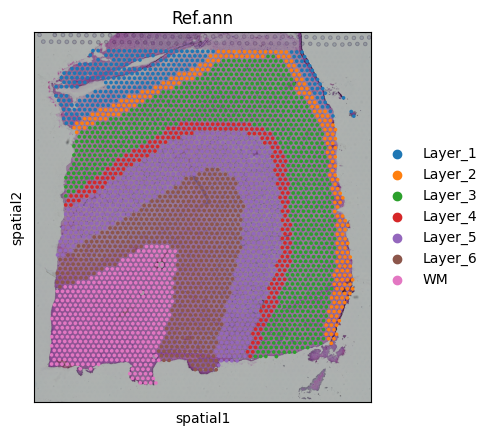

In [910]:
sc.pl.spatial(t, color="celltype", show=False, title=["Ref.ann"])
plt.savefig("HE_ann.pdf", dpi=300)

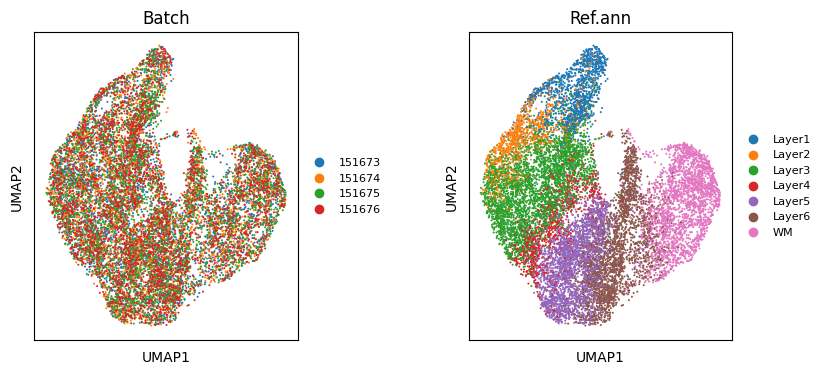

In [954]:
tmp_data = tmp_dict["spatialign"]["data"].copy()
id_mapping = {"0": "151673", "1": "151674", "2": "151675", "3": "151676"}
tmp_data.obs["mapping_batch"] = tmp_data.obs["batch"].map(id_mapping)

fig, ax = plt.subplots(1, 2, figsize=(9, 4))
sc.pl.umap(tmp_data, color="mapping_batch", title="Batch", ax=ax[0], show=False, legend_fontsize=8)
sc.pl.umap(tmp_data, color="celltype", title="Ref.ann", ax=ax[1], show=False, legend_fontsize=8)
fig.subplots_adjust(wspace=0.65, hspace=0)
fig.savefig("spatialign_ump.pdf", dpi=150, bbox_inches="tight")

### -----------------------------

In [ ]:
sc.pl.umap(tmp_dict["raw"]["data"], color=["batch", "celltype", "leiden", "mappingtype"])

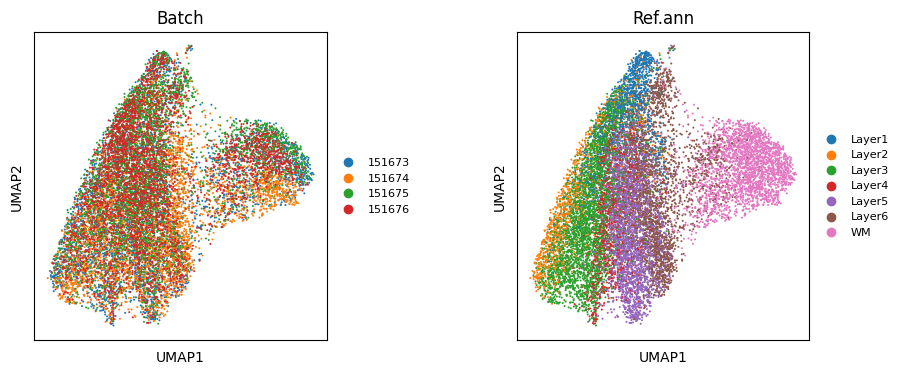

In [957]:
tmp_data = tmp_dict["raw"]["data"].copy()
id_mapping = {"0": "151673", "1": "151674", "2": "151675", "3": "151676"}
tmp_data.obs["mapping_batch"] = tmp_data.obs["batch"].map(id_mapping)

fig, ax = plt.subplots(1, 2, figsize=(10, 4))
sc.pl.umap(tmp_data, color="mapping_batch", title="Batch", ax=ax[0], show=False, legend_fontsize=8)
sc.pl.umap(tmp_data, color="celltype", title="Ref.ann", ax=ax[1], show=False, legend_fontsize=8)
fig.subplots_adjust(wspace=0.65, hspace=0)
fig.savefig("raw_ump.pdf", dpi=150, bbox_inches="tight")

In [1258]:
def f_beta_lisi2(ilisi, clisi, beta=2):
    ilisi_m = ilisi.mean()
    clisi_m = clisi.mean()
    score = ((1 + beta ** 2) * (ilisi_m * (1 - clisi_m))) / (((beta ** 2)*ilisi_m + (1 - clisi_m)))
    return score

In [1264]:
for key in names:
    mean_ilisi = np.mean(tmp_dict[key]["ilisi"])
    mean_clisi = np.mean(1 - tmp_dict[key]["clisi"])
    a = f_beta_lisi(tmp_dict[key]["ilisi"], tmp_dict[key]["clisi"], beta=0.5)
    b = f_beta_lisi2(tmp_dict[key]["ilisi"], tmp_dict[key]["clisi"], beta=0.5)
    print(f"{key}-> {a:.4f}, {b:.4f}, {mean_ilisi:.4f}, {mean_clisi:.4f}")
    

spatialign-> 0.8624, 0.8192, 0.8057, 0.8778
precast-> 0.8390, 0.8064, 0.7961, 0.8505
graphst-> 0.7861, 0.8742, 0.9082, 0.7605
scalex-> 0.6846, 0.7908, 0.8339, 0.6553
harmony-> 0.8188, 0.8187, 0.8187, 0.8188
combat-> 0.7825, 0.7134, 0.6930, 0.8086
bbknn-> 0.7990, 0.7425, 0.7254, 0.8197
scanorama-> 0.8101, 0.7431, 0.7232, 0.8352
mnn-> 0.0491, 0.0129, 0.0103, 0.8005


In [1266]:
for key in names:
    mean_ilisi = np.mean(tmp_dict[key]["ilisi"])
    mean_clisi = np.mean(1 - tmp_dict[key]["clisi"])
    a = f_beta_lisi(tmp_dict[key]["ilisi"], tmp_dict[key]["clisi"], beta=1)
    b = f_beta_lisi2(tmp_dict[key]["ilisi"], tmp_dict[key]["clisi"], beta=1)
    print(f"{key}-> {a:.4f}, {b:.4f}, {mean_ilisi:.4f}, {mean_clisi:.4f}")
    

spatialign-> 0.8402, 0.8402, 0.8057, 0.8778
precast-> 0.8224, 0.8224, 0.7961, 0.8505
graphst-> 0.8278, 0.8278, 0.9082, 0.7605
scalex-> 0.7339, 0.7339, 0.8339, 0.6553
harmony-> 0.8187, 0.8187, 0.8187, 0.8188
combat-> 0.7463, 0.7463, 0.6930, 0.8086
bbknn-> 0.7697, 0.7697, 0.7254, 0.8197
scanorama-> 0.7752, 0.7752, 0.7232, 0.8352
mnn-> 0.0204, 0.0204, 0.0103, 0.8005
